In [1]:
%load_ext autoreload
%autoreload 2

# load dependencies
import pandas as pd
import geopandas as gpd
import numpy as np
import seaborn as sns
from datetime import datetime
import pysal
import libpysal #added
pd.options.mode.chained_assignment = None 
from geofeather import to_geofeather, from_geofeather
from matplotlib import pyplot as plt
from pysal import esda 
import numpy as np
from pyproj import CRS
from pyproj import Transformer
#import skmob

from envirocar import TrackAPI, DownloadClient, BboxSelector, ECConfig

# create an initial but optional config and an api client
config = ECConfig()
track_api = TrackAPI(api_client=DownloadClient(config=config))

C:\Anaconda\envs\python3\lib\site-packages\pysal\__init__.py:65: VisibleDeprecationWarning: PySAL's API will be changed on 2018-12-31. The last release made with this API is version 1.14.4. A preview of the next API version is provided in the `pysalnext` package. The API changes and a guide on how to change imports is provided at https://migrating.pysal.org
  ), VisibleDeprecationWarning)


## Functions

In [2]:
inputCRS = CRS.from_epsg(4326)
outputCRS = CRS.from_epsg(25832)
transformer = Transformer.from_crs(inputCRS, outputCRS)
def project(a,b):
    return transformer.transform(a, b)

In [3]:
def getisOrd(data, value = 'value', threshold = 50, lat = 'lat', lng = 'lng'):
    coords = [project(row[lat], row[lng]) for index, row in data.iterrows()]
    w = libpysal.weights.DistanceBand(coords, threshold)         #w = pysal.weights.DistanceBand(coords, threshold)
    #getisOrdGlobal = esda.getisord.G(data_speed['time_sec'], w)
    getisOrdLocal = esda.getisord.G_Local(data[value], w, transform='B')
    getisOrdLocal.Zs

    data['z_score'] = getisOrdLocal.Zs
    data['p_value'] = getisOrdLocal.p_norm

    return data

In [4]:
def pltcolor(p_value, z_score, confidence):
    cols=[]
    size=[]
    for p, z in zip(p_value, z_score):
        if p < confidence:
            if z > 0:
                cols.append('red')        #hotspot color
                size.append(20)
            else:
                cols.append('blue')       #coldspot color
                size.append(20)
        else:
            cols.append('grey')           #others
            size.append(10)
    return cols , size

In [5]:
def plot(data, lat = 'lat', lng = 'lng', p_field = 'p_value', z_field = 'z_score'):
    from matplotlib import pyplot as plt
    #z_score>1.96 hot spots (95% ci)
    #z_score<-1.96 cold spots
    from matplotlib import colors as cls

    f, axarr = plt.subplots(1, figsize=(10,10))
    total_range = cls.Normalize(vmin = - 1.96, vmax = 1.96)
    
    cols, sizes = pltcolor(data[p_field], data[z_field], 0.05)

    plt.scatter(x=data['lng'], y=data['lat'], s=sizes, c=cols, lw = 0) #Pass on the list created by the function here
    plt.grid(True)
    plt.show()

In [6]:
def makepopup(t):
        return str(t)

In [7]:
def map(data, value = 'value', lat = 'lat', lng = 'lng', p_field = 'p_value', z_field = 'z_score'):
    import folium

    lats = data[lat]
    lngs = data[lng]

    #z-value
    z = data[z_field]
    p = data[p_field]

    avg_lat = sum(lats) / len(lats)
    avg_lngs = sum(lngs) / len(lngs)

    m = folium.Map(location=[avg_lat, avg_lngs], tiles = 'Stamen Terrain', zoom_start=12)

    color, sizes = pltcolor(p, z, 0.05)
    value = data[value]

    
    for lat,lng,c,s,v in zip(lats, lngs, color, sizes, value):
        folium.CircleMarker([lat,lng], color = c, radius = s/3, fill = c, popup = makepopup(v)).add_to(m)
    m
    return m

# Data Import
EnviroCar tracks data is imported and saved in geofeather format, which is a faster for geometries with geopandas. Tracks are also clipped by the initial bounding box to cut out the tracks extending beyond the extent of bounding box.

In [22]:
## Mönchengladbach bbox coordinates
bbox = BboxSelector([
    6.3301849365234375, # min_x
    51.13369295212583, # min_y
    6.540985107421875, # max_x
    51.23870648334856  # max_y
])
# issue a query
track_df = track_api.get_tracks(bbox=bbox, num_results=500) # requesting 500 tracks inside the bbox
track_df.head()

,id,time,geometry,GPS Bearing.value,GPS Bearing.unit,Intake Temperature.value,Intake Temperature.unit,MAF.value,MAF.unit,Intake Pressure.value,...,Consumption.value,Consumption.unit,Throttle Position.value,Throttle Position.unit,track.appVersion,track.touVersion,O2 Lambda Voltage.value,O2 Lambda Voltage.unit,O2 Lambda Voltage ER.value,O2 Lambda Voltage ER.unit
0,5b46294f44ea850910a1c1e0,2018-07-11T06:07:23,POINT (6.41455 51.20328),117.943870,deg,28.000001,c,35.669282,l/s,120.000001,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,5b46294f44ea850910a1c1e2,2018-07-11T06:07:28,POINT (6.41512 51.20308),115.088323,deg,28.000000,c,31.446508,l/s,113.073678,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,5b46294f44ea850910a1c1e3,2018-07-11T06:07:33,POINT (6.41564 51.20299),106.541059,deg,28.000000,c,28.072108,l/s,112.068772,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,5b46294f44ea850910a1c1e4,2018-07-11T06:07:38,POINT (6.41615 51.20291),99.885196,deg,28.000000,c,33.429661,l/s,129.759303,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,5b46294f44ea850910a1c1e5,2018-07-11T06:07:43,POINT (6.41671 51.20282),104.435649,deg,27.999999,c,25.774274,l/s,106.020177,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [25]:
#bounding box polygon in geodataframe
from shapely.geometry import Polygon
bboxpoly = Polygon([(6.3301849365234375, 51.13369295212583,), 
                                       (6.540985107421875,51.13369295212583), 
                                       (6.540985107421875, 51.23870648334856 ), 
                                       (6.3301849365234375,51.23870648334856)])
bboxpoly_gdf = gpd.GeoDataFrame([1],geometry=[bboxpoly])

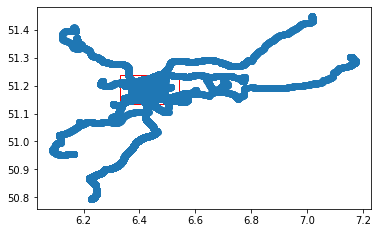

In [26]:
#plotting the tracks and bounding box shows the extending tracks
base = bboxpoly_gdf.plot(color='white', edgecolor='red')
track_df.plot(ax=base)

In [29]:
#clipping track_df by bboxpoly_gdf
track_df_copy = track_df.reset_index(drop = True)
clipTracks_df = gpd.clip(track_df_copy, bboxpoly_gdf)

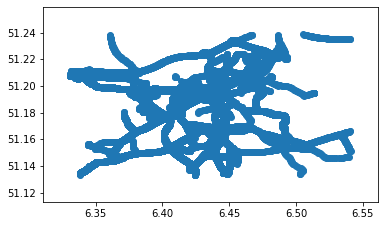

In [38]:
clipTracks_df.plot()

In [8]:
#conversion to feather format
data_path = 'Data/Monchengladbach_500.feather'
clipTracks_df.reset_index(inplace = True)
to_geofeather(clipTracks_df, data_path)

NameError: name 'clipTracks_df' is not defined

In [9]:
#checking data
track_df_500 = from_geofeather('Data/Monchengladbach_500.feather')
track_df_500.columns

Index(['level_0', 'index', 'id', 'time', 'geometry', 'GPS Bearing.value',
       'GPS Bearing.unit', 'Intake Temperature.value',
       'Intake Temperature.unit', 'MAF.value', 'MAF.unit',
       'Intake Pressure.value', 'Intake Pressure.unit', 'Engine Load.value',
       'Engine Load.unit', 'GPS Accuracy.value', 'GPS Accuracy.unit',
       'GPS Altitude.value', 'GPS Altitude.unit', 'Rpm.value', 'Rpm.unit',
       'GPS Speed.value', 'GPS Speed.unit', 'GPS VDOP.value', 'GPS VDOP.unit',
       'GPS PDOP.value', 'GPS PDOP.unit', 'Speed.value', 'Speed.unit',
       'GPS HDOP.value', 'GPS HDOP.unit', 'track.id', 'track.length',
       'track.begin', 'track.end', 'sensor.type', 'sensor.engineDisplacement',
       'sensor.model', 'sensor.id', 'sensor.fuelType',
       'sensor.constructionYear', 'sensor.manufacturer',
       'Calculated MAF.value', 'Calculated MAF.unit', 'CO2.value', 'CO2.unit',
       'Consumption.value', 'Consumption.unit', 'Throttle Position.value',
       'Throttle Position

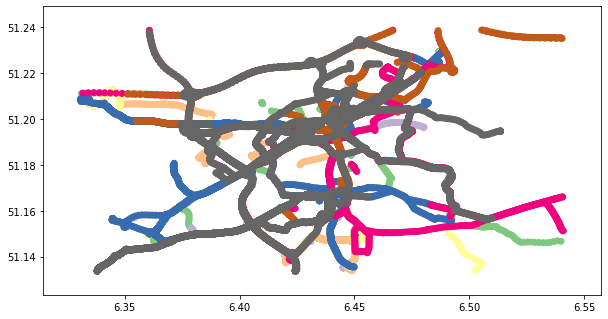

In [113]:
track_df_500.plot(figsize=(10, 12), c=track_df_500['id'], cmap = 'Accent')
#color based on track id

### Hotspots For Vehicle Speed


count    20569.000000
mean         3.667509
std          1.047842
min          0.000000
25%          3.000000
50%          3.000000
75%          5.000000
max         15.000000
Name: time_diff, dtype: float64

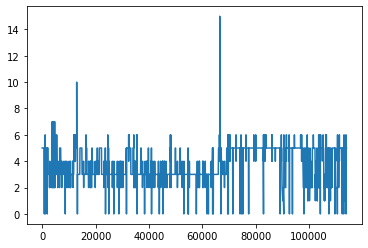

In [11]:
## select stopping times data
df_speed = track_df_500

# convert the date column to datetime type
df_speed['time_datetime'] = pd.to_datetime(df_speed['time'], format = "%Y-%m-%dT%H:%M:%S")
df_speed['time_diff'] = (df_speed['time_datetime'] - df_speed['time_datetime'].shift()).fillna(pd.Timedelta('0 days'))
df_speed['time_diff'] = df_speed['time_diff'].apply(lambda x: x.total_seconds())

##identify first record in each track and adding a default value of 0
tracks_id = (df_speed['id'].groupby(df_speed['track.id']).nth(0)).tolist()
df_speed['time_diff'][df_speed['id'].isin(tracks_id)] = 0

### select tracks with speed = 0
df_speed = df_speed[df_speed['Speed.value'] == 0]

### plot times
plt.plot(df_speed['time_diff'])
df_speed['time_diff'].describe()

count    16578.000000
mean         4.550428
std          3.553199
min          0.000000
25%          3.000000
50%          3.000000
75%          5.000000
max        130.000000
Name: time_diff, dtype: float64

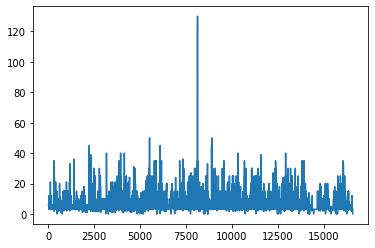

In [12]:
##get coordinates
df_speed['lat'] = df_speed['geometry'].apply(lambda coord: coord.y)
df_speed['lng'] = df_speed['geometry'].apply(lambda coord: coord.x)

## group by location
data_speed = df_speed.groupby(['lat','lng'])[['time_diff']].sum().reset_index()

### plot times
plt.plot(data_speed['time_diff'])
data_speed['time_diff'].describe()

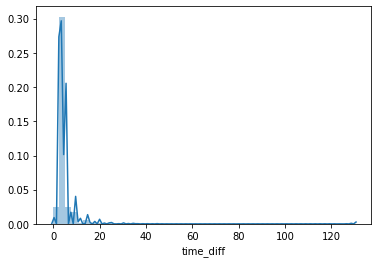

In [17]:
sns.distplot(data_speed['time_diff'])

C:\Anaconda\envs\python3\lib\site-packages\libpysal\weights\weights.py:167: UserWarning: The weights matrix is not fully connected: 
 There are 558 disconnected components.
 There are 92 islands with ids: 571, 993, 1500, 1596, 1696, 2160, 2243, 2244, 2322, 2469, 2570, 2684, 2935, 2937, 3002, 3741, 3804, 4006, 4822, 4831, 5025, 5053, 5110, 5396, 5470, 5535, 5616, 5618, 5725, 5763, 5784, 6003, 6049, 6091, 6179, 6354, 6432, 6614, 6651, 6679, 6706, 6802, 6812, 6875, 6887, 7091, 7562, 7669, 7853, 8240, 8246, 8666, 8677, 8681, 8888, 9266, 9572, 10108, 11247, 11821, 12050, 12251, 12309, 12319, 12320, 12863, 12960, 13482, 13811, 13971, 13976, 14011, 14134, 14147, 14149, 14150, 14153, 14195, 14204, 14235, 14236, 14965, 15195, 15200, 15291, 15335, 15708, 15746, 15770, 16312, 16313, 16443.
  warnings.warn(message)
C:\Anaconda\envs\python3\lib\site-packages\pysal\esda\getisord.py:434: RuntimeWarning: invalid value encountered in true_divide
  self.Zs = (self.Gs - self.EGs) / np.sqrt(self.VGs)
C:\A

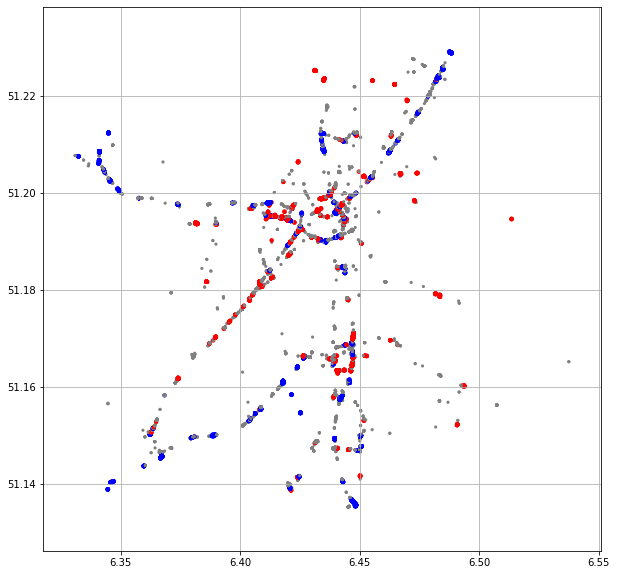

In [13]:
speedGetis = getisOrd(data_speed, 'time_diff', 30)
plot(speedGetis)

In [14]:
map(speedGetis, 'time_diff')

In [30]:
len(speedGetis[speedGetis['p_value'] < 0.05])
speedGetis

,lat,lng,time_diff,z_score,p_value
0,51.135224,6.445199,6.0,1.290525,0.098434
1,51.135225,6.445199,6.0,1.290525,0.098434
2,51.135225,6.445177,6.0,1.290525,0.098434
3,51.135225,6.445201,6.0,1.290525,0.098434
4,51.135229,6.445201,6.0,1.290525,0.098434
...,...,...,...,...,...
16573,51.229116,6.487625,3.0,-1.936995,0.026373
16574,51.229116,6.487624,3.0,-1.936995,0.026373
16575,51.229117,6.487624,3.0,-1.936995,0.026373
16576,51.229118,6.487624,3.0,-1.936995,0.026373


In [74]:
zip_codes = gpd.read_file('Data/MC_division.geojson')
getis_speed = gpd.GeoDataFrame(speedGetis, geometry=gpd.points_from_xy(speedGetis.lng, speedGetis.lat), crs='epsg:4326')
track_df_join = gpd.sjoin(zip_codes, getis_speed)
speed_zip = track_df_join.dissolve(by='Nummer', aggfunc='mean')
speed_zip.head()

,geometry,index_right,lat,lng,time_diff,z_score,p_value
Nummer,,,,,,,
101,"POLYGON Z ((6.39534 51.21819 0.00000, 6.39534 ...",15537.775701,51.217166,6.432159,6.289720,1.972312,0.172089
102,"POLYGON Z ((6.44132 51.21972 0.00000, 6.44173 ...",14228.751979,51.206219,6.445032,4.104881,-1.470341,0.079141
103,"POLYGON Z ((6.42674 51.19860 0.00000, 6.42495 ...",10657.937372,51.196477,6.422958,5.365503,3.484375,0.129040
104,"POLYGON Z ((6.44434 51.19423 0.00000, 6.44241 ...",10000.857273,51.195239,6.437676,4.961130,1.246592,0.124928
105,"POLYGON Z ((6.41787 51.19069 0.00000, 6.41789 ...",10486.062885,51.195942,6.411994,4.420469,-0.010331,0.048681


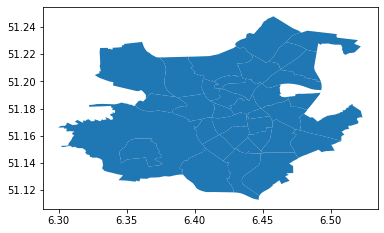

In [104]:
speed_zip.plot()

In [111]:
time_diff = speed_zip['time_diff']
shapelist = gpd.read_file('Data/speed_zip.shp').geometry.tolist()
W = pysal.queen_from_shapefile('Data/speed_zip.shp')

StopIteration: 

In [24]:
traffic_lights = gpd.read_file('Data/Traffic_lights_city.geojson')
traffic_lights.head()

,id,@id,highway,traffic_signals,crossing,TMC:cid_58:tabcd_1:Class,TMC:cid_58:tabcd_1:LCLversion,TMC:cid_58:tabcd_1:LocationCode,TMC:cid_58:tabcd_1:NextLocationCode,TMC:cid_58:tabcd_1:PrevLocationCode,...,tactile_paving,traffic_calming,ele,maxspeed,side,description,foot,crossing:island,kerb,geometry
0,node/87225547,node/87225547,traffic_signals,None,None,None,None,None,None,None,...,None,None,None,None,None,None,None,None,None,MULTIPOINT (6.46556 51.21058)
1,node/87225564,node/87225564,traffic_signals,None,None,None,None,None,None,None,...,None,None,None,None,None,None,None,None,None,MULTIPOINT (6.47429 51.21641)
2,node/87225575,node/87225575,traffic_signals,None,None,None,None,None,None,None,...,None,None,None,None,None,None,None,None,None,MULTIPOINT (6.47925 51.22051)
3,node/87225834,node/87225834,traffic_signals,None,None,None,None,None,None,None,...,None,None,None,None,None,None,None,None,None,MULTIPOINT (6.46336 51.21235)
4,node/87225893,node/87225893,traffic_signals,None,None,None,None,None,None,None,...,None,None,None,None,None,None,None,None,None,MULTIPOINT (6.47456 51.20406)


### Hotspots For CO2 Emmission

In [114]:
track_df_500['CO2.value'].describe()

count    78549.000000
mean         5.021449
std          6.588853
min          0.000000
25%          0.000000
50%          2.248281
75%          7.220174
max         71.339660
Name: CO2.value, dtype: float64

In [ ]:
CO2 = track_df_500.dropna(subset = ['CO2.value'])
len(CO2)

In [ ]:
CO2['lat'] = CO2['geometry'].apply(lambda coord: coord.y)
CO2['lng'] = CO2['geometry'].apply(lambda coord: coord.x)
CO2['CO2'] = CO2['CO2.value']
# df_CO2.head()
data_CO2 = CO2.groupby(['lat','lng'])[['CO2']].sum().reset_index()
data_CO2.head()

In [ ]:
getisCO2 = getisOrd(data_CO2, 'CO2', 50)
plot(getisCO2)

In [ ]:
map(getisCO2, 'CO2')